In [1]:
import math
from IPython.display import SVG
import svgwrite

# Prompt the user for the size of the shape
size = 500 #int( input("Enter the size of the shape: "))
Frame = size+5

# Prompt the user for the number of vertexes
num_vertexes = 8 #int( input("Enter the number of vertexes: "))

# Prompt the user for the angle of the shape
angle = 0 # int( input("Enter the angle of the shape (in degrees): "))

# Convert the angle to radians
angle_rad = math.radians(angle)

# Prompt the user for the colors of the shapes
#colors = []
#for i in range(4):
#    color = input(f"Enter color {i+1} (in hexicode): ")
#    colors.append(color)
colors = input("Enter colors (in hexicode): ").split(',')

def draw_shape(doc, size, num_vertexes, angle, colors, frame):
    # Calculate the center of the image
    center_x = int(frame) / 2
    center_y = int(frame) / 2

    # Create a list of points for the shape
    points = []
    for i in range(num_vertexes):
        temp_angle = 2 * 3.14 * i / num_vertexes + angle
        x = center_x + size/2 * math.cos(temp_angle)
        y = center_y + size/2 * math.sin(temp_angle)
        points.append((x, y))

    # Add the shape to the center of the image
    shape = doc.polygon(points)
    shape.fill(color=colors[0], opacity=1)
    shape.stroke(color=colors[1], width=3)
    doc.add(shape)

    # Recursively draw smaller shapes inside the original shape
    if size > (frame/25):
        draw_shape(doc, size -10, num_vertexes, (angle+math.radians(24))%(math.radians(360)), colors[::-1], frame)

# Create an SVG document
doc = svgwrite.Drawing(filename='shapes.svg', size=(Frame, Frame))

# Draw the shape
draw_shape(doc, size, num_vertexes, angle, colors, Frame)

# Save the SVG file
doc.save()
SVG('shapes.svg')

KeyboardInterrupt: Interrupted by user

In [106]:
#Winter
#472183,#4B56D2,#82C3EC,#F1F6F5

In [ ]:
#Bubblegum
#FF597B,#FF8E9E,#F9B5D0,#EEEEEE

In [ ]:
#Poipull
#FBFACD,#7F669D,#DEBACE,#BA94D1

In [178]:
#forestFire
#002F35,#FF6337,#FFA323,#004A2F

In [196]:
#Slate and Spark
#F8B500,#F7F7F7,#5C636E,#393E46

In [1]:
#Retro 
#CF0A0A,#000000,#DC5F00,#EEEEEE

Pass: (723, 1, 4)


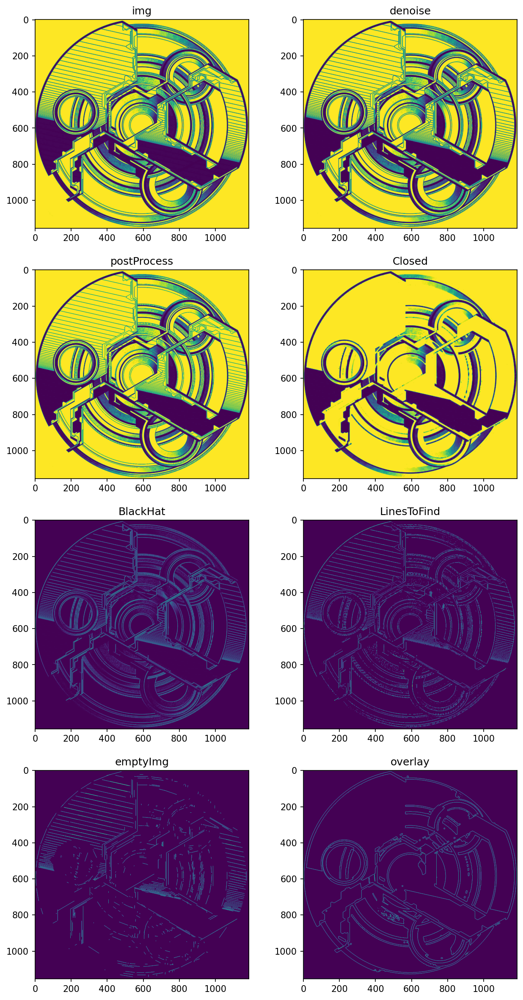

In [416]:
import cv2
import numpy as np
import svgwrite
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def png_to_svg(input_filename, output_filename):
    # Load the input image as a grayscale image
    img = cv2.imread(input_filename, cv2.IMREAD_GRAYSCALE)[135:1290,130:1315]

    denoise = cv2.bitwise_and(img,np.zeros(img.shape, dtype="uint8")+np.uint8(252))
    
    #processed = np.ma.masked_where(img>=250, np.ma.masked_where(img<5, img).filled(fill_value=0)).filled(fill_value=255)
    postProcess = cv2.morphologyEx(denoise, cv2.MORPH_CLOSE, np.ones((2,2),np.uint8))
    Closed = cv2.morphologyEx(postProcess, cv2.MORPH_CLOSE, np.ones((5,5),np.uint8))
    _,ShapesToFind = cv2.threshold(Closed,150,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
    
    
    BlackHat = cv2.morphologyEx(denoise, cv2.MORPH_BLACKHAT, np.ones((2,2),np.uint8))
    AdaptiveThreshold =cv2.adaptiveThreshold(BlackHat,255,cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY,55,-1)
    LinesToFind = cv2.morphologyEx(AdaptiveThreshold, cv2.MORPH_ERODE, np.ones((2,2),np.uint8))

    
    # Create an SVG image using the svgwrite library
    dwg = svgwrite.Drawing(output_filename, size=(img.shape[1], img.shape[0]))
    
    # Find lines using the Hough transform
    lines = cv2.HoughLinesP(LinesToFind, 1, np.pi/180, 50, minLineLength=3, maxLineGap=5)

    emptyImg = np.zeros(img.shape, dtype="uint8")
    # Mask the lines on the image
    if lines is not None:
        print(f'Pass: {lines.shape}')
        for line in lines:
            x1, y1, x2, y2 = line[0]
            cv2.line(emptyImg, (x1, y1), (x2, y2), (255, 255, 255), 1) 
            dwg.add( svgwrite.shapes.Line( (float(x1), float(y1)), (float(x2), float(y2)), stroke="black", stroke_width=1 )  )
    
    # Find contours in the image
    contours, _ = cv2.findContours(ShapesToFind, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)

    anotheremptyImg = np.zeros(img.shape, dtype="uint8")

    overlay = cv2.drawContours(image=anotheremptyImg, contours=contours, contourIdx=-1, color=(255, 255, 255), thickness=1)#, lineType=cv2.LINE_AA)

    # Iterate over the contours and draw each one as a smooth curve on the SVG image
    for contour in contours:
        # Approximate the contour with a smooth curve
        curve = cv2.approxPolyDP(contour, 0.001 * cv2.arcLength(contour, True), True)

        # Convert the curve points from (x, y) coordinates to (x, y) tuples
        curve_points = [(float(point[0][0]), float(point[0][1])) for point in curve]    
    
        # Draw the curve on the SVG image
        dwg.add(dwg.polyline(curve_points, fill="none", stroke="black", stroke_width=1))
            
    # Save the SVG image
    dwg.save()
        
    a=4
    b=2
    
    fig = plt.figure(figsize=(10, 20), dpi=150)
    plt.tight_layout()
    
    title = ['img', 'denoise', 'postProcess', 'Closed', 'BlackHat', 'LinesToFind', 'emptyImg', 'overlay']
    counter = 1
    for i in [img, denoise, postProcess, Closed, BlackHat, LinesToFind, emptyImg, overlay]:
        plt.subplot(a, b, counter)
        plt.title(f'{title[counter-1]}')
        plt.imshow(i)
        counter = counter+1
    plt.show()    
        
# Test the png_to_svg function
png_to_svg('steve.png', 'steveSVG.svg')



In [180]:
"blue"

'blue'

In [ ]:
    opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, np.ones((3,3),np.uint8) )
    #closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, np.ones((7,7),np.uint8) )
    img = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, np.ones((7,7),np.uint8), iterations = 1 )
    #_,threshHIGH = cv2.threshold(opening,5,255,cv2.THRESH_BINARY)
    #_,thresh = cv2.threshold(img,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)


In [ ]:
    a=4
    b=2
    
    fig = plt.figure(figsize=(10, 20), dpi=150)
    plt.tight_layout()
    
    title = ['OGimg', 'OGedges', 'CircleImg', 'CircleEdges', 'linesImg', 'linesEdges', 'overlay']
    counter = 1
    for i in [OGimg, OGedges, CircleImg, CircleEdges, linesImg, linesEdges, overlay]:
        plt.subplot(a, b, counter)
        plt.title(f'{title[counter-1]}')
        plt.imshow(i)
        counter = counter+1
    plt.show()

numpy.ndarray

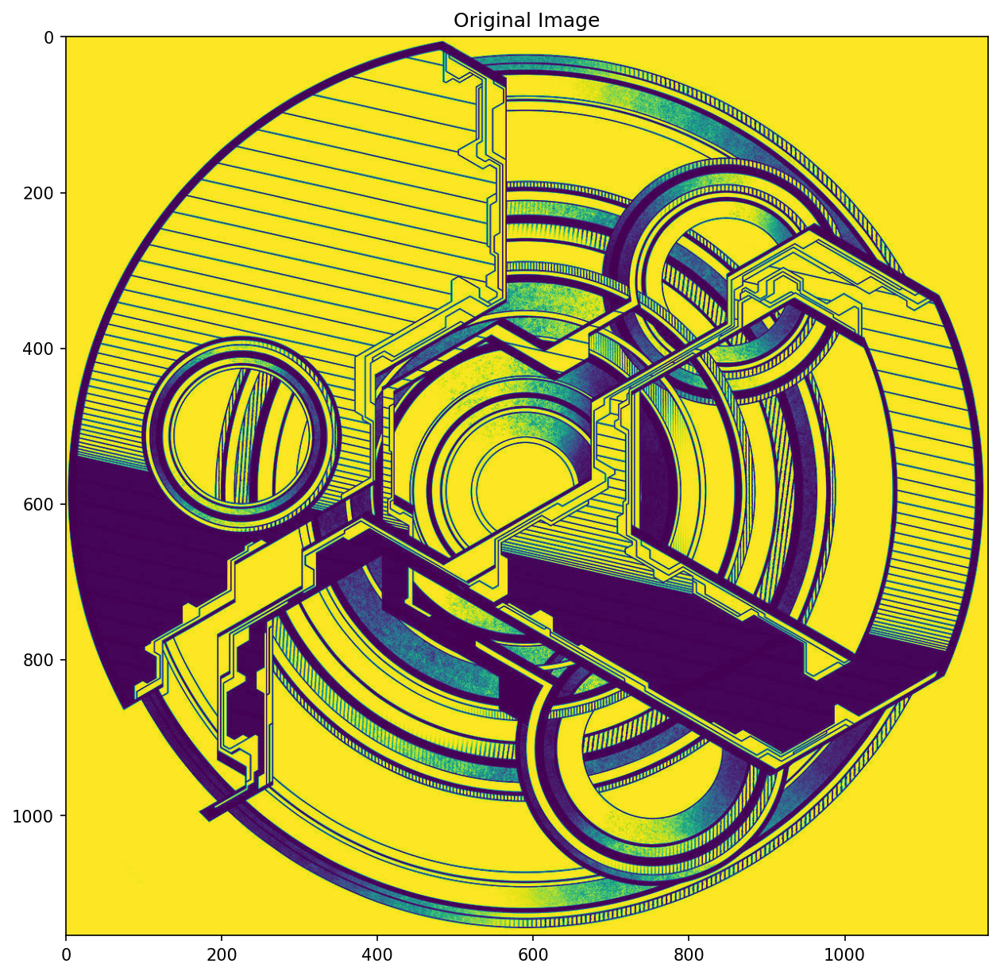

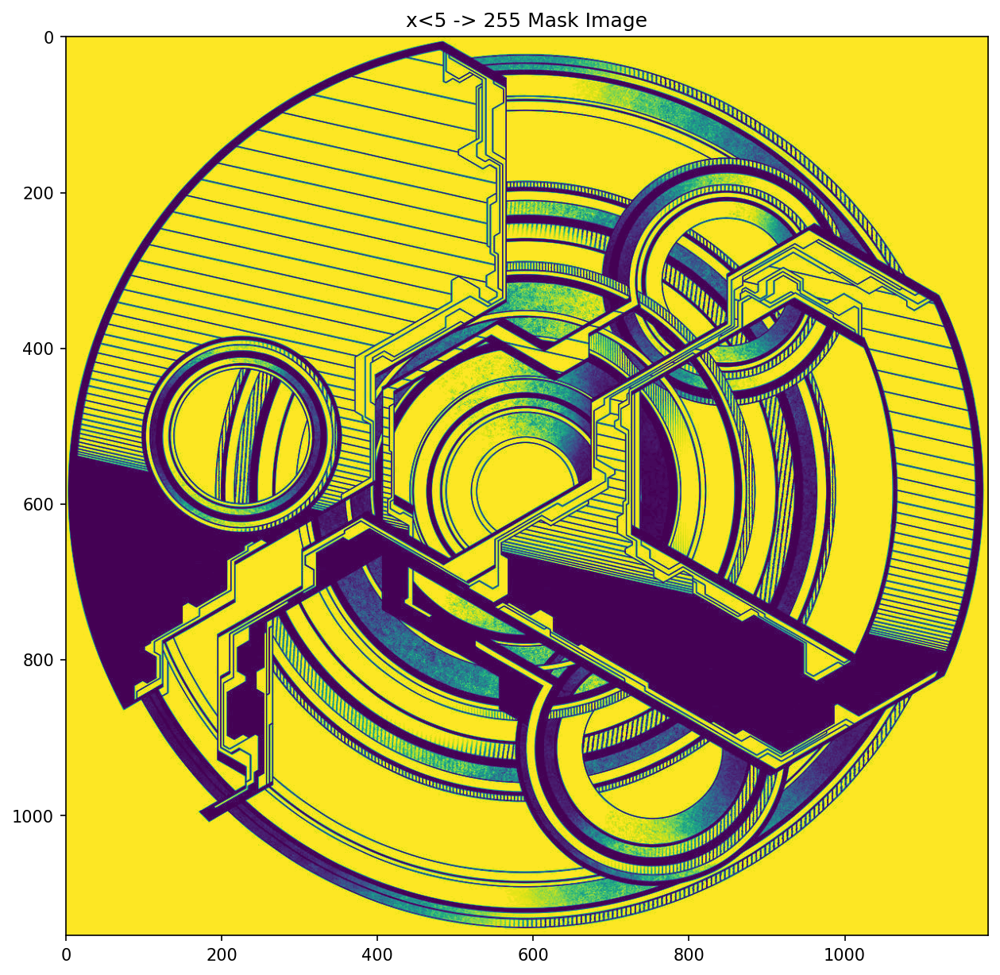

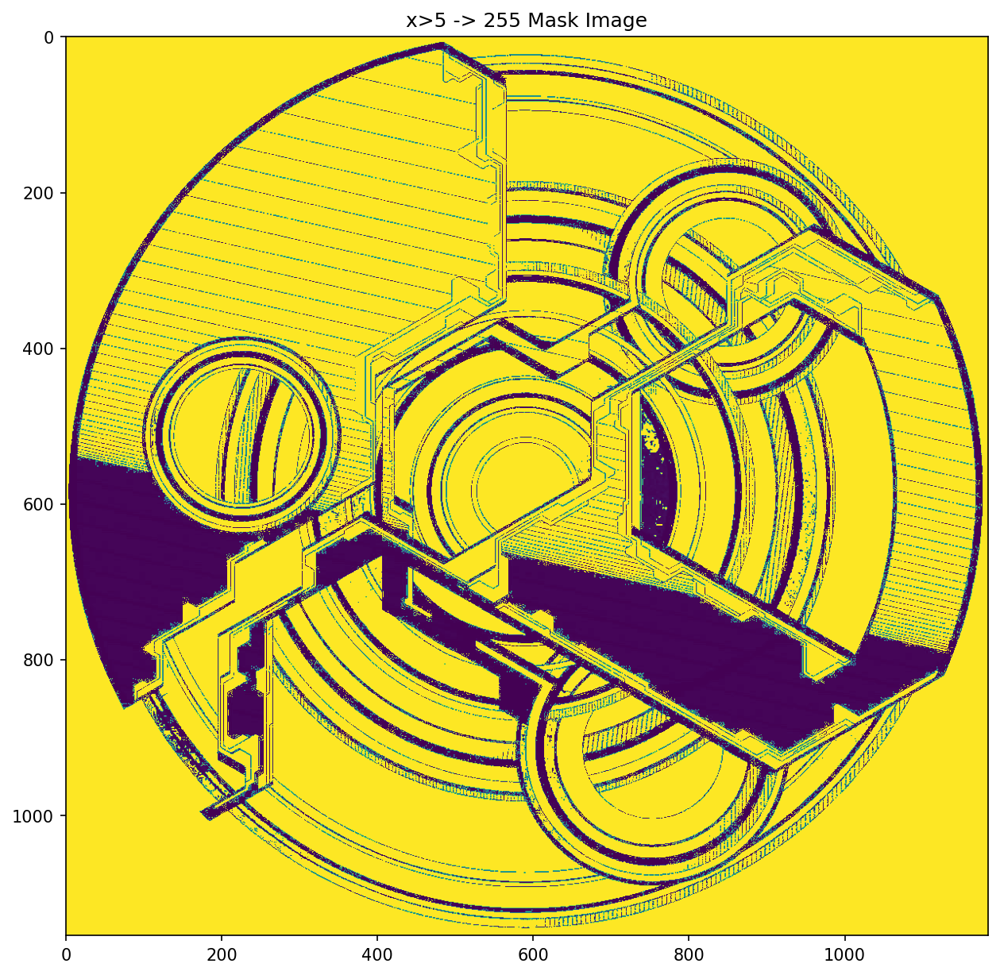

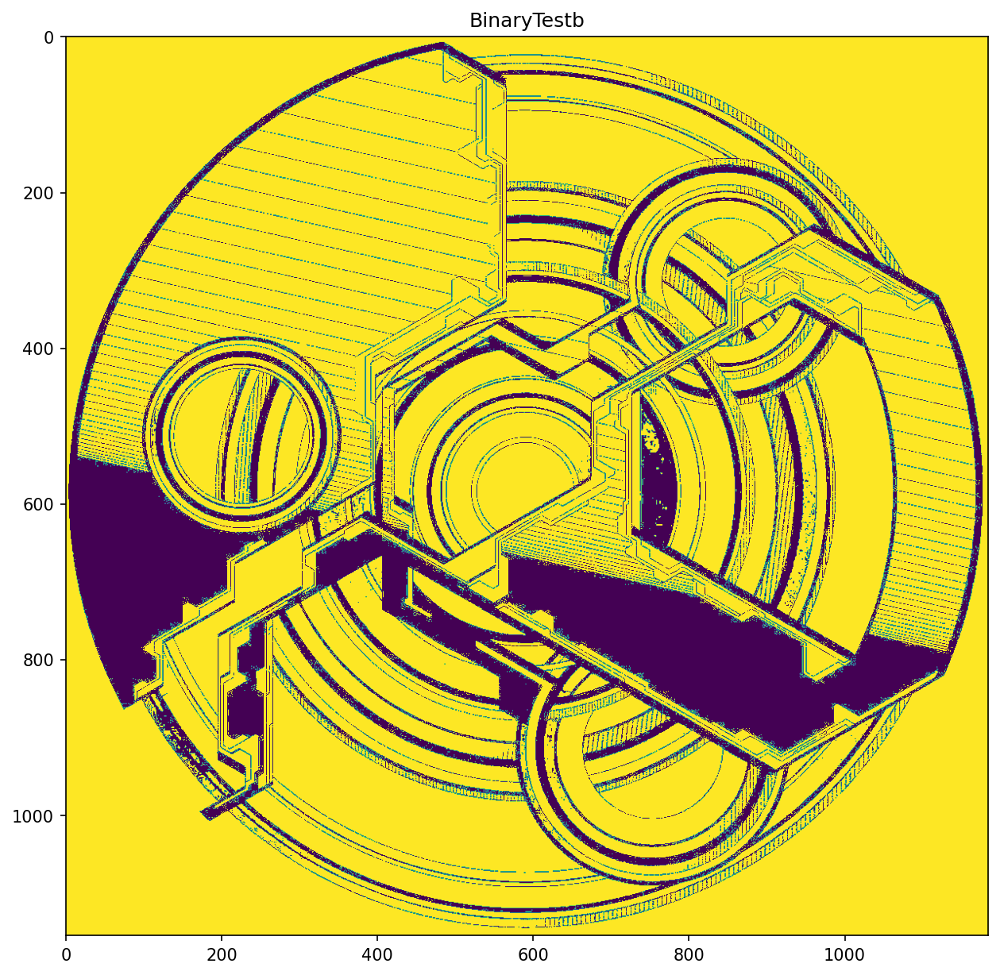

In [290]:
img = cv2.imread('steve.png', cv2.IMREAD_GRAYSCALE)[135:1290,130:1315]
plt.figure(figsize=(10, 10), dpi=150)
plt.title('Original Image')
plt.imshow(img)

test = np.ma.masked_where(img>=250, np.ma.masked_where(img<5, img).filled(fill_value=0))
plt.figure(figsize=(10, 10), dpi=150)
plt.title('x<5 -> 255 Mask Image')
plt.imshow(test.filled(fill_value=255))

testb = np.ma.masked_where(img >= 10, img)
plt.figure(figsize=(10, 10), dpi=150)
plt.title('x>5 -> 255 Mask Image')
plt.imshow(testb.filled(fill_value=255))

_,BinaryTestb = cv2.threshold(testb.filled(fill_value=255),20,255,cv2.THRESH_BINARY)
plt.figure(figsize=(10, 10), dpi=150)
plt.title('BinaryTestb')
plt.imshow(BinaryTestb)

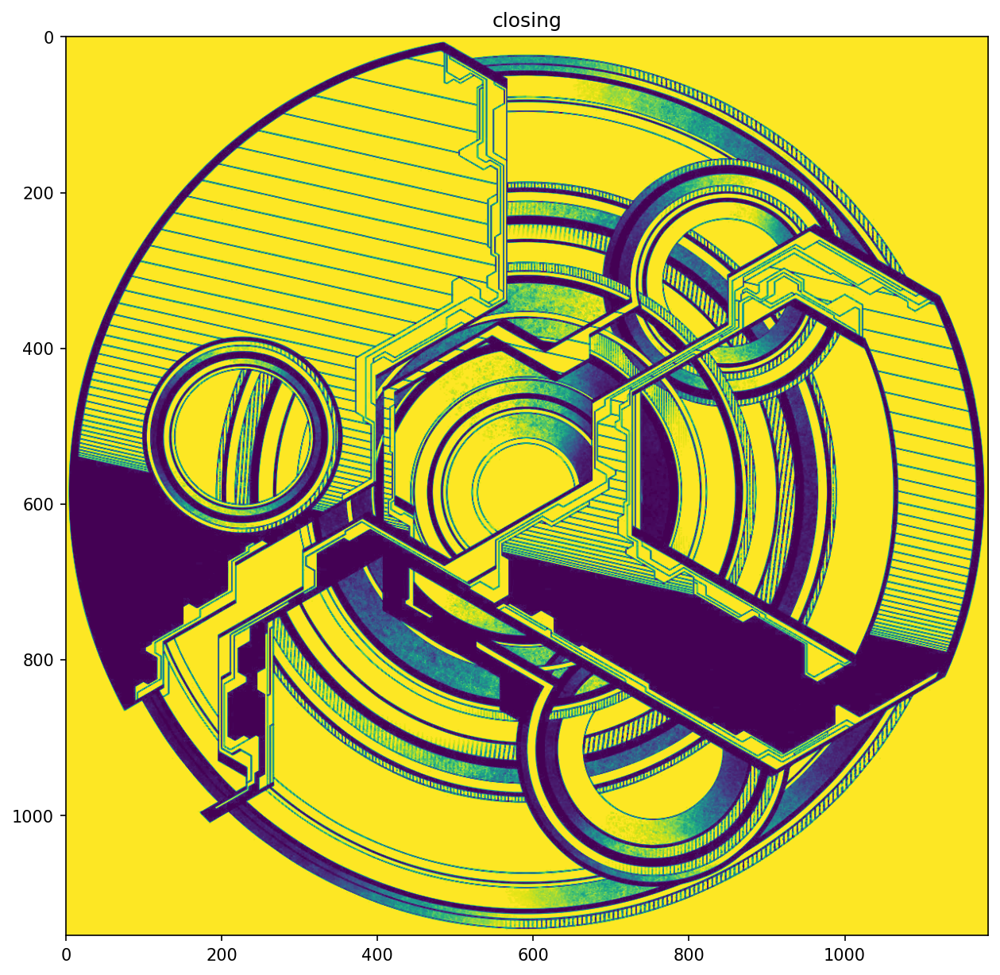

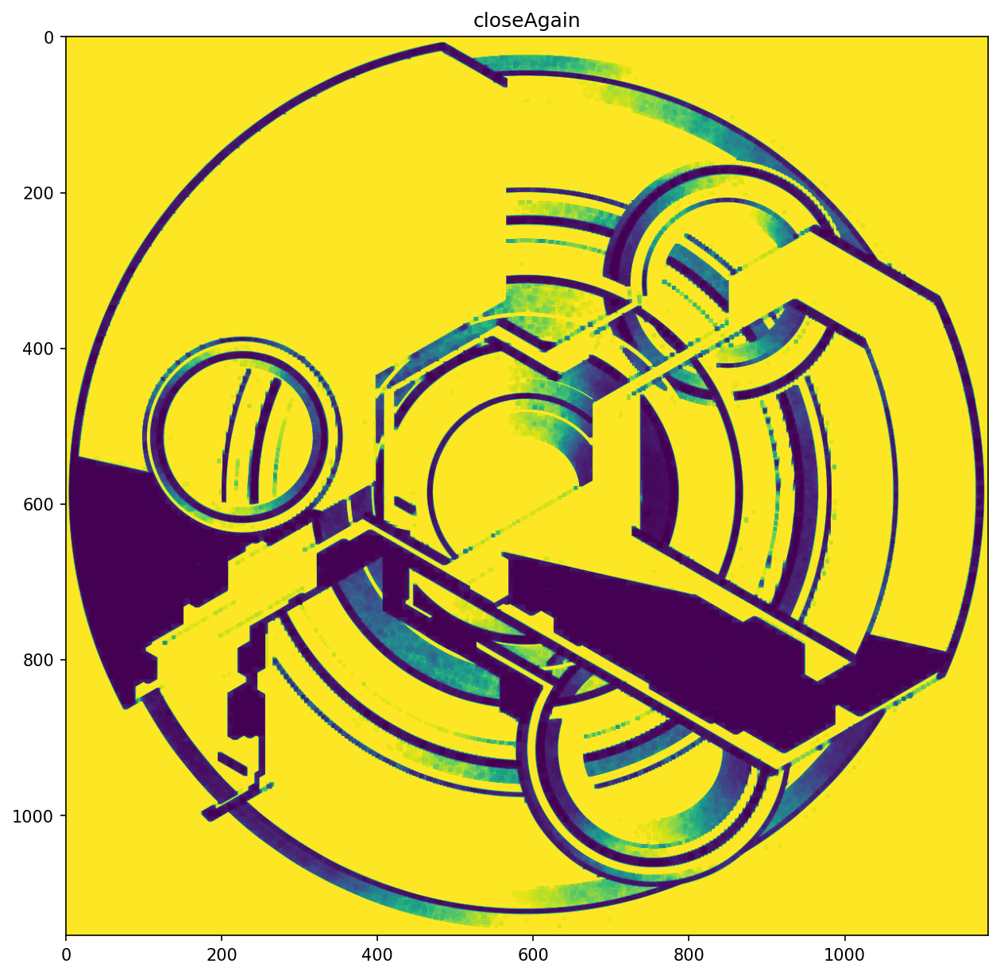

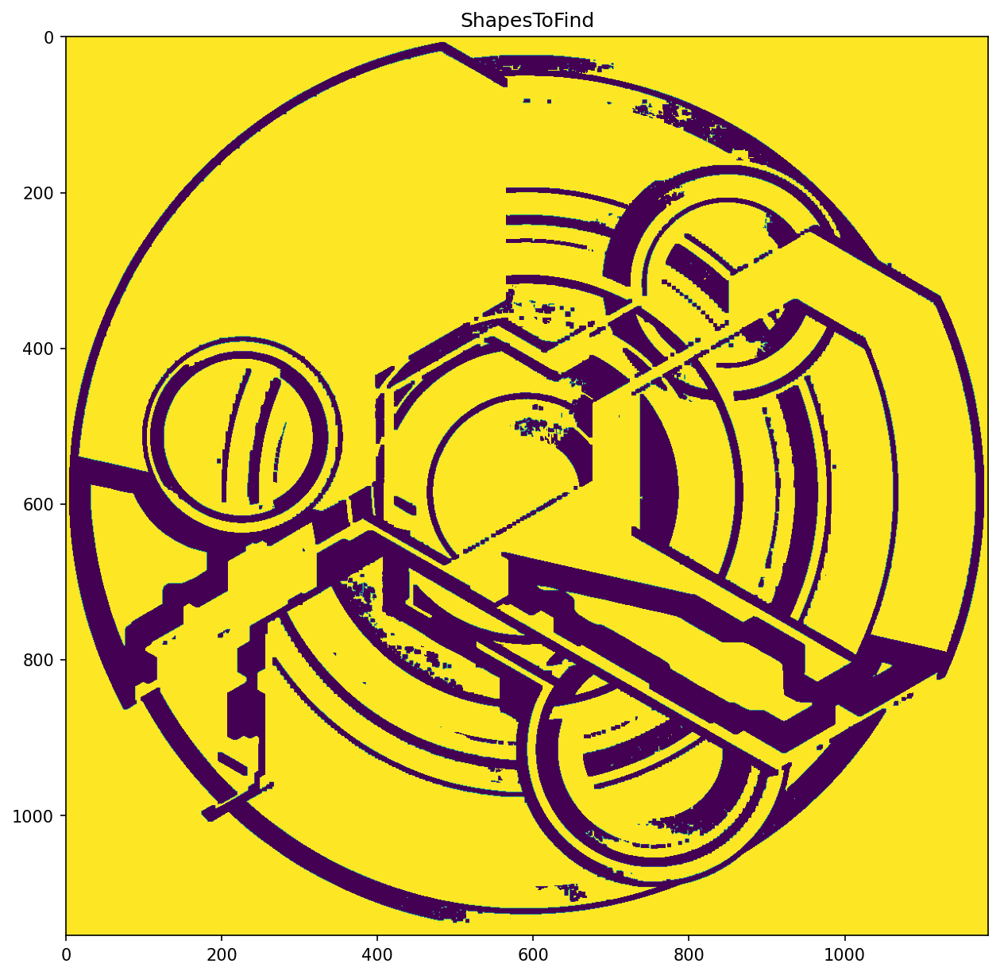

In [425]:
closing = cv2.morphologyEx(test.filled(fill_value=255), cv2.MORPH_CLOSE, np.ones((2,2),np.uint8), iterations=1)
plt.figure(figsize=(10, 10), dpi=150)
plt.title('closing')
plt.imshow(closing)

#plt.hist(closing.ravel(),256,[0,256]);

closeAgain = cv2.morphologyEx(closing, cv2.MORPH_CLOSE, np.ones((5,5),np.uint8))
plt.figure(figsize=(10, 10), dpi=150)
plt.title('closeAgain')
plt.imshow(closeAgain)

#_,ShapesToFind = cv2.threshold(closeAgain,15,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
ShapesToFind =cv2.adaptiveThreshold( closeAgain,255,cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY,55,0.1)
plt.figure(figsize=(10, 10), dpi=150)
plt.title('ShapesToFind')
plt.imshow(ShapesToFind)


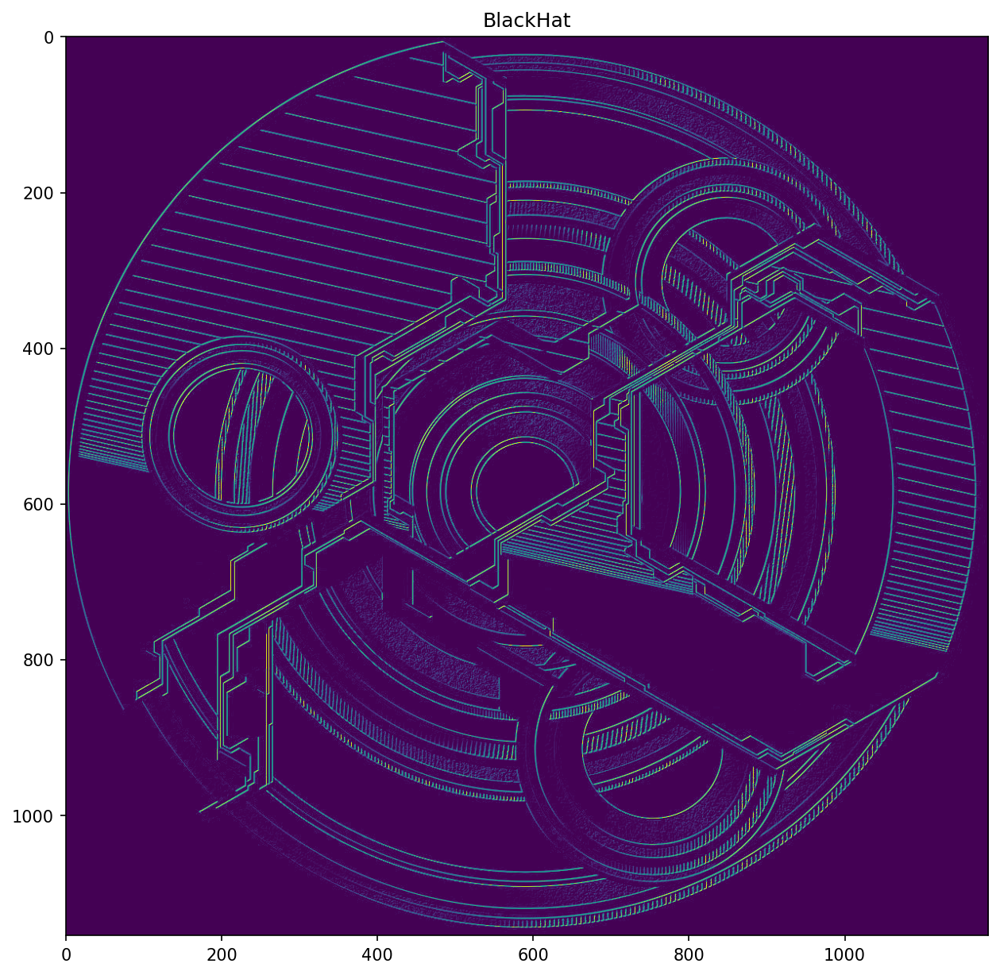

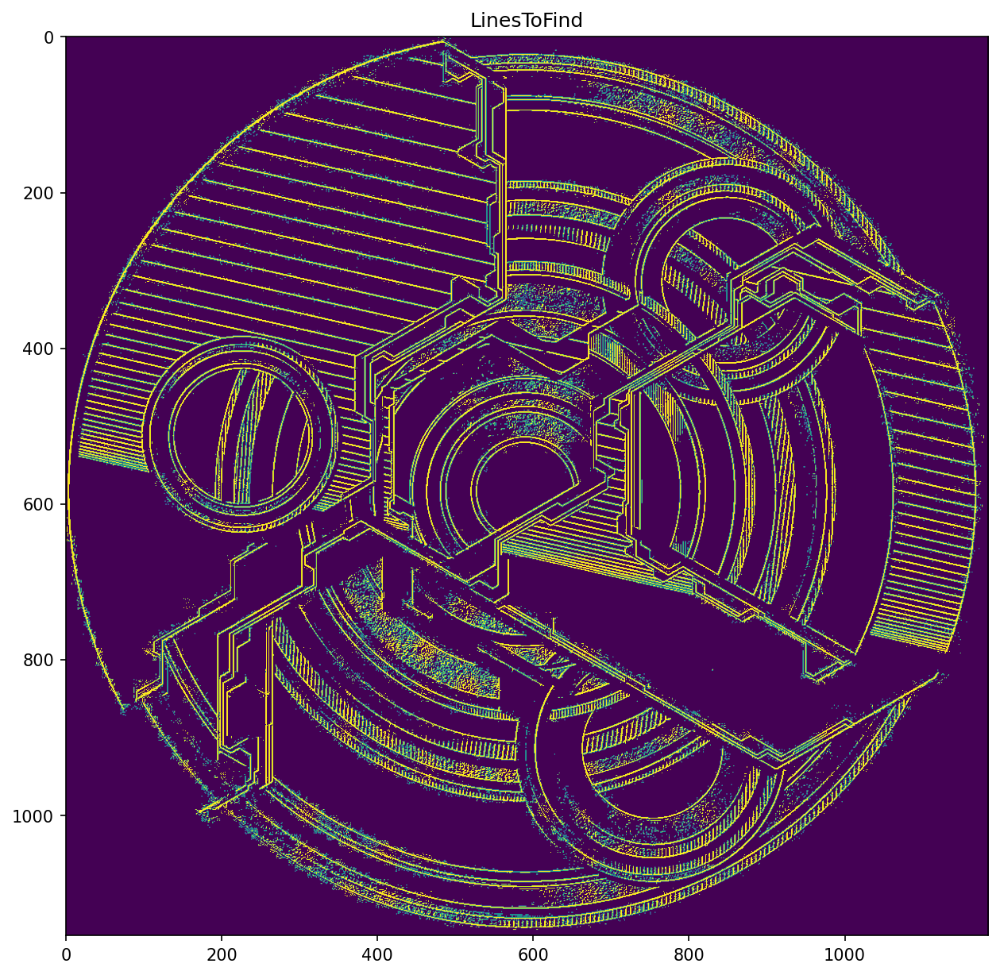

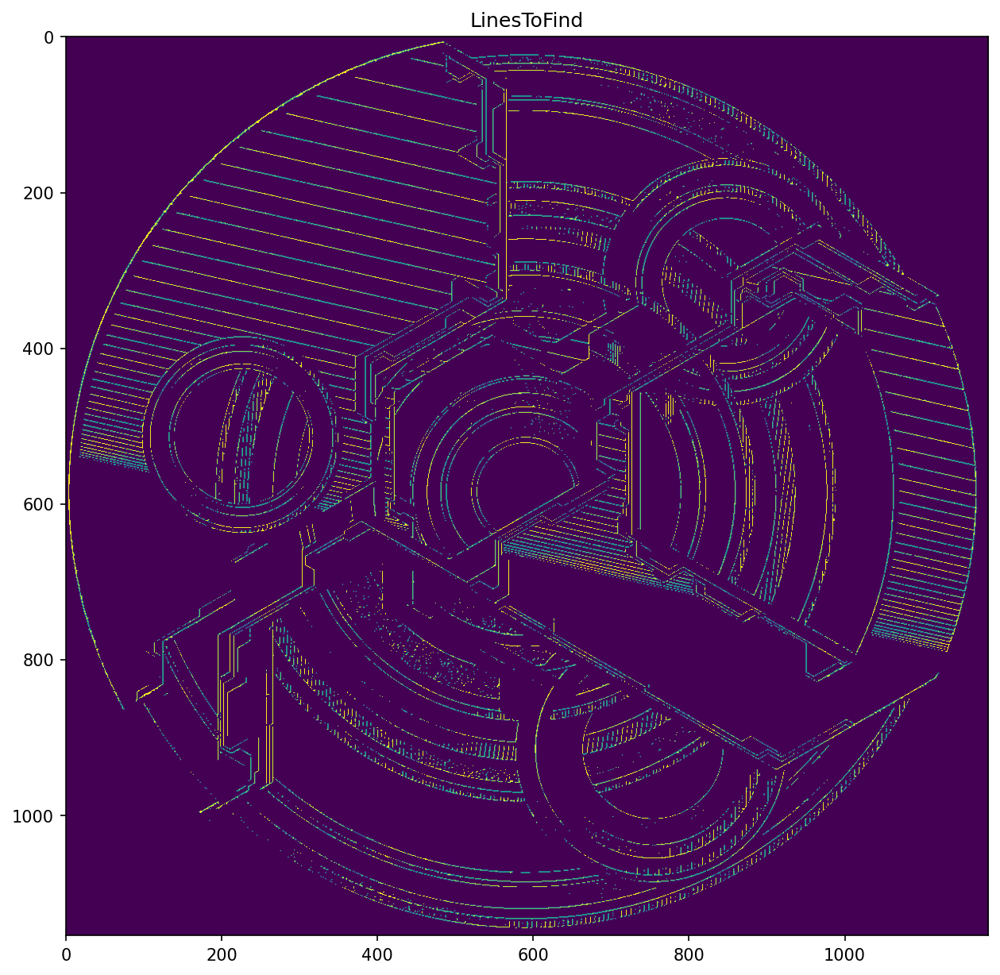

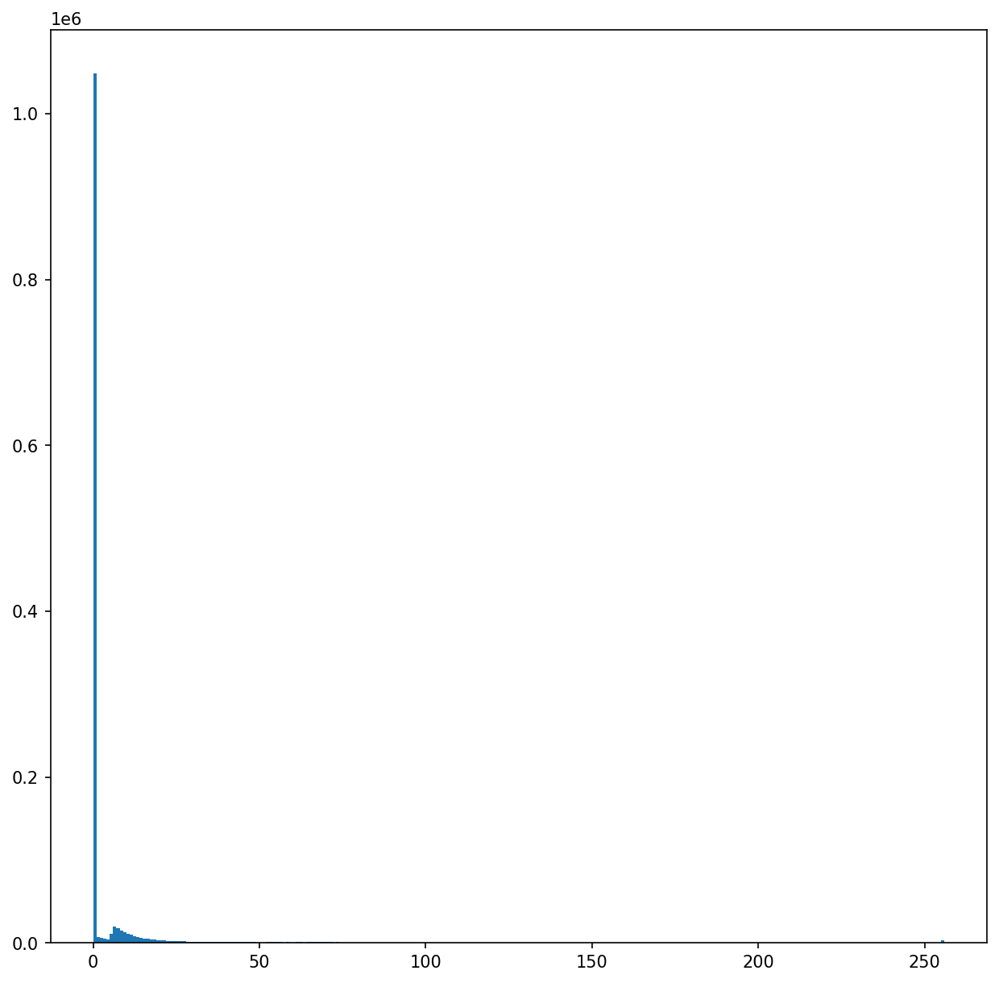

In [414]:
BlackHat = cv2.morphologyEx(test.filled(fill_value=255), cv2.MORPH_BLACKHAT, np.ones((2,2),np.uint8)  )
#BlackHat = cv2.morphologyEx(BlackHat, cv2.MORPH_ERODE, np.ones((2,2),np.uint8)  )

plt.figure(figsize=(10, 10), dpi=150)
plt.title('BlackHat')
plt.imshow(BlackHat)

ShapesToFind =cv2.adaptiveThreshold(BlackHat,255,cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY,155,-1)
plt.figure(figsize=(10, 10), dpi=150)
plt.title('LinesToFind')
plt.imshow(ShapesToFind)

ShapesToFind = cv2.morphologyEx(ShapesToFind, cv2.MORPH_ERODE, np.ones((2,2),np.uint8)  )

plt.figure(figsize=(10, 10), dpi=150)
plt.title('LinesToFind')
plt.imshow(ShapesToFind)

plt.figure(figsize=(10, 10), dpi=150)

plt.hist(BlackHat.ravel(),256,[0,256]);



<ipython-input-456-4786991cfc09>:12: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(a/2, 2, i+1)


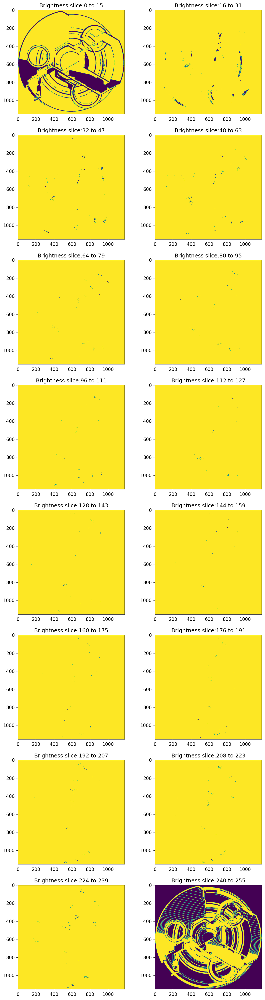

In [456]:
img = cv2.imread('steve.png', cv2.IMREAD_GRAYSCALE)[135:1290,130:1315]

denoise = cv2.bitwise_and(img,np.zeros(img.shape, dtype="uint8")+np.uint8(240))
    
postProcess = cv2.morphologyEx(denoise, cv2.MORPH_CLOSE, np.ones((2,2),np.uint8))

    
fig = plt.figure(figsize=(10, 40), dpi=150)
plt.tight_layout()
a=16
for i in range(a):
    plt.subplot(a/2, 2, i+1)
    plt.title(f'Brightness slice:{i*a} to {i*a+(a-1)}')
        
    out = np.ma.masked_where(postProcess>=(i*a)+(a-1), np.ma.masked_where(postProcess<(i*a),postProcess).filled(fill_value=255)).filled(fill_value=255) 

    Closed = cv2.morphologyEx(out, cv2.MORPH_CLOSE, np.ones((3,3),np.uint8))

    _,ShapesToFind = cv2.threshold(Closed,(i*a),255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)

    
    #edges = cv2.Canny(ShapesToFind, (i*a)+(a/4), (i*a)+(a/2), apertureSize = 3, L2gradient = True)

    
    

    plt.imshow(ShapesToFind)

plt.show()
    

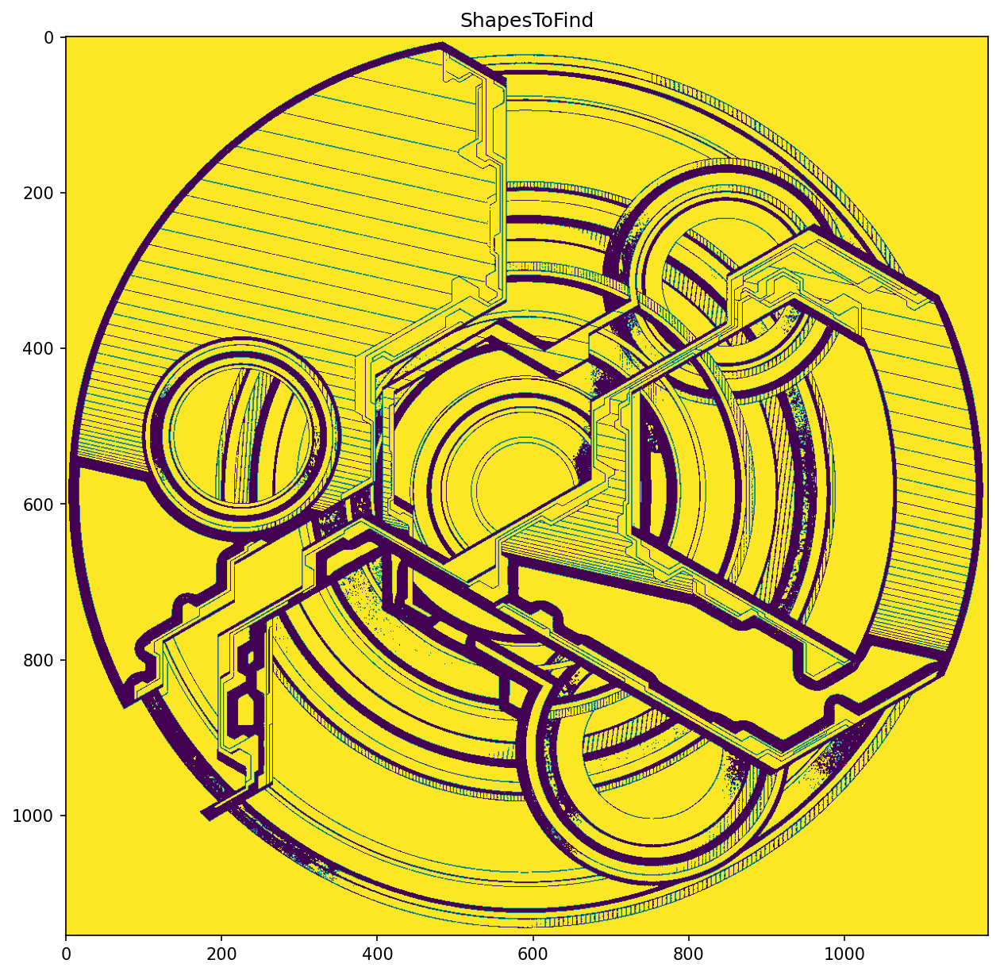

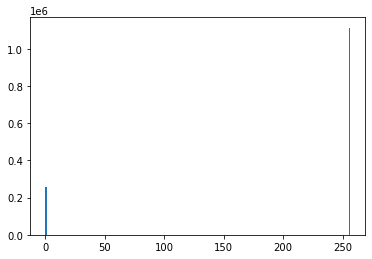

In [564]:
img = cv2.imread('steve.png', cv2.IMREAD_GRAYSCALE)[135:1290,130:1315]

denoise = cv2.bitwise_and(img,np.zeros(img.shape, dtype="uint8")+np.uint8(240))

masked = np.ma.masked_where(denoise>16,denoise).filled(fill_value=255)

ShapesToFind = cv2.adaptiveThreshold(masked,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,31,1)


fig = plt.figure(figsize=(10, 40), dpi=150)
plt.title('ShapesToFind')
plt.imshow(ShapesToFind)
plt.show() 


plt.hist(ShapesToFind.ravel(),256,[0,256]);


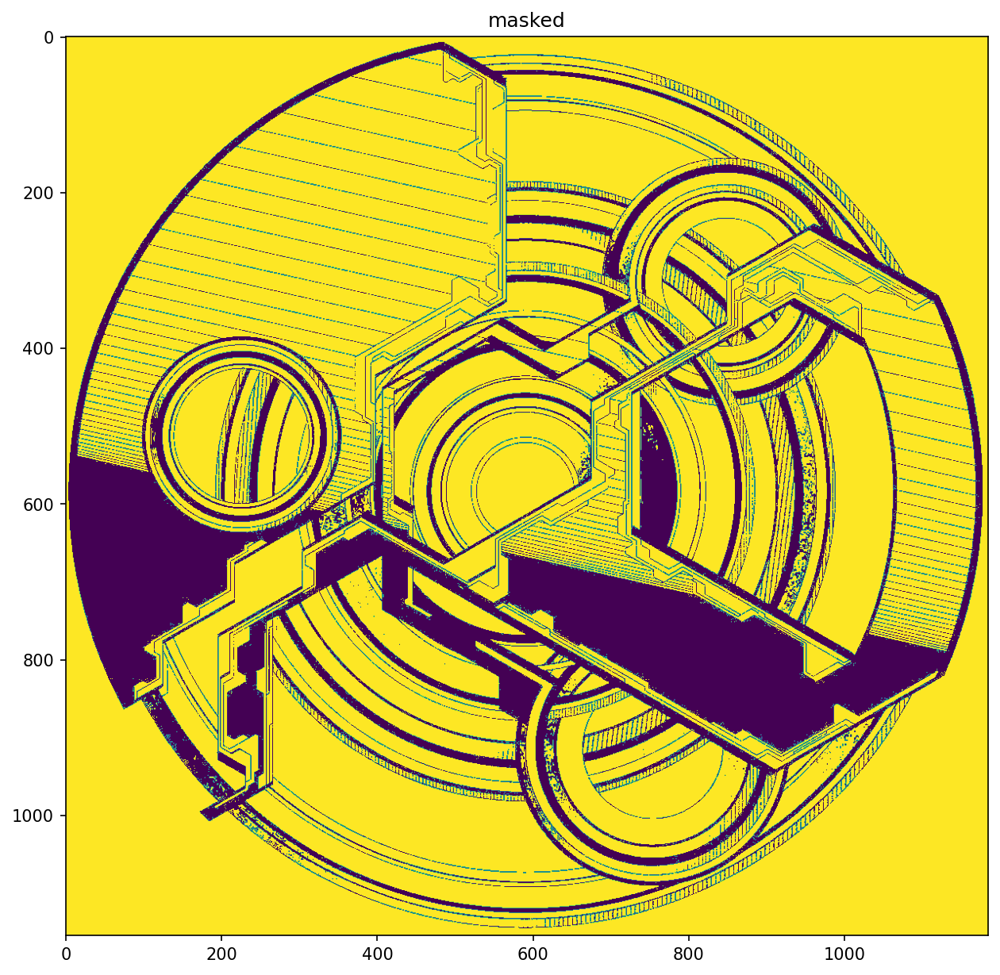

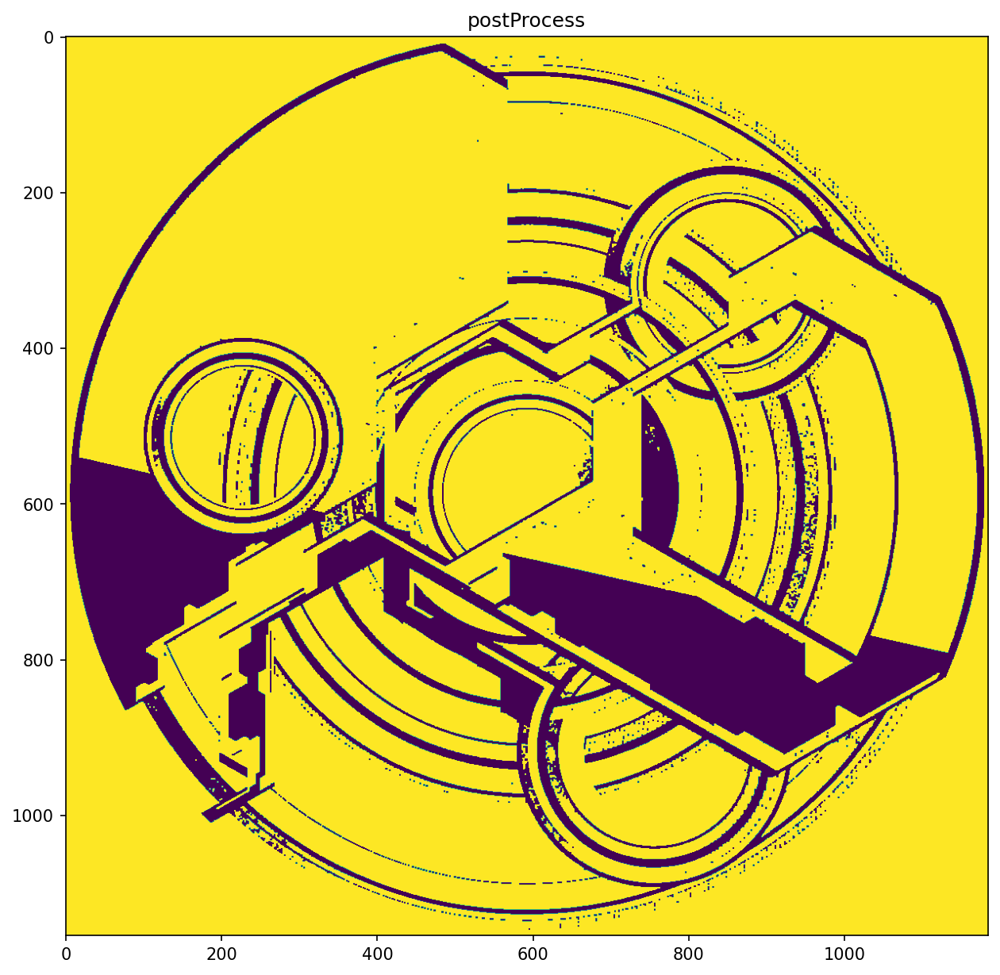

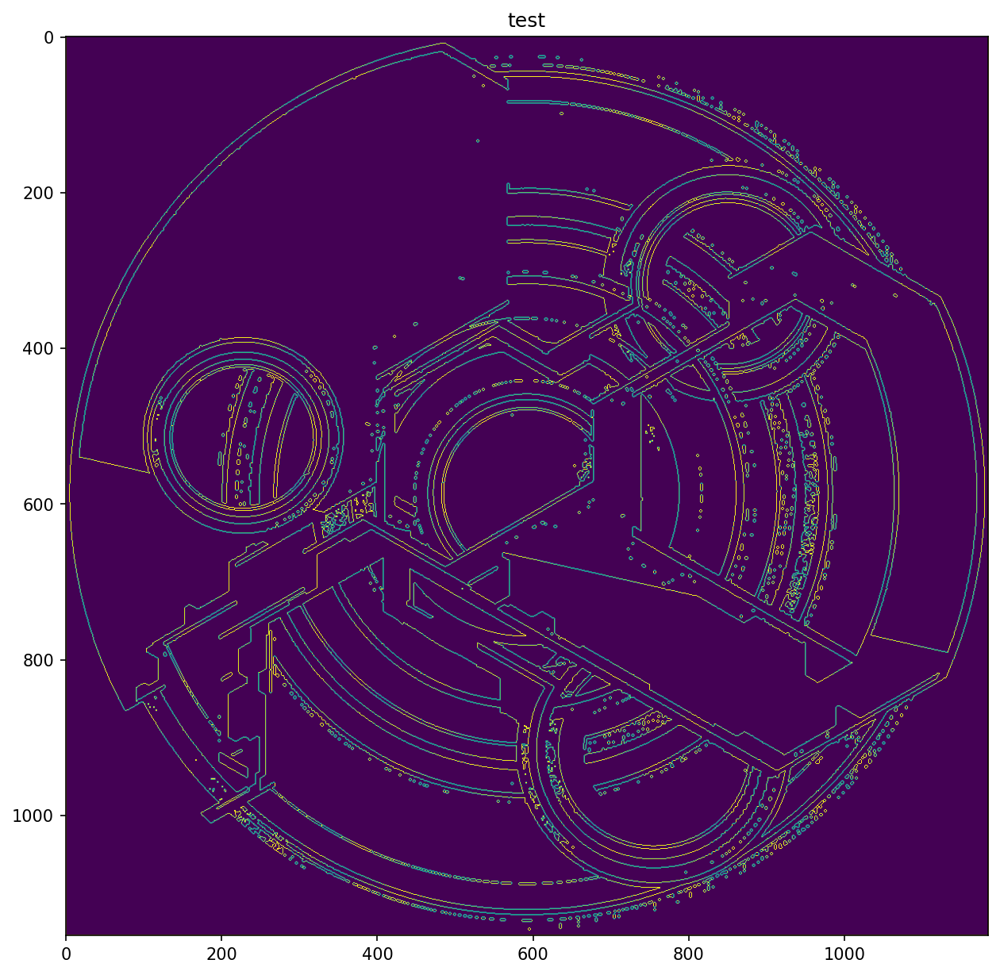

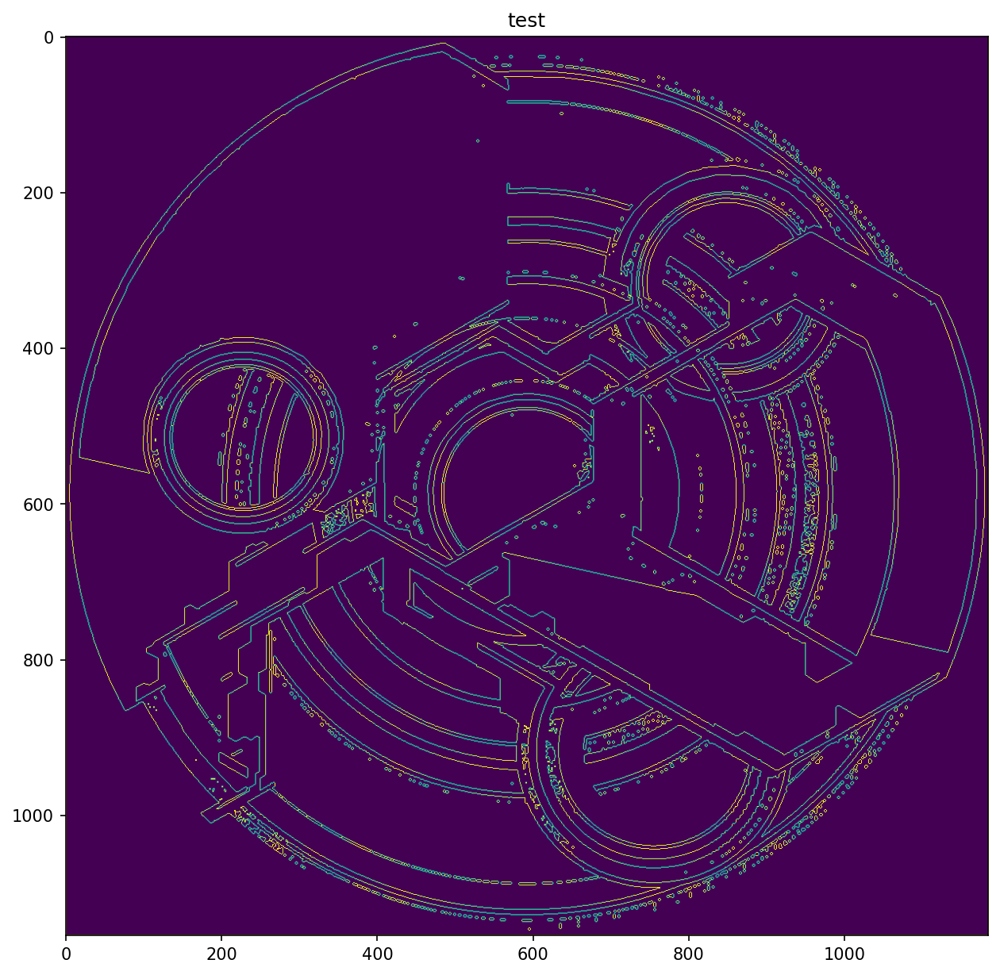

In [559]:
masked = np.ma.masked_where(denoise>10,denoise).filled(fill_value=255)

fig = plt.figure(figsize=(10, 40), dpi=150)
plt.title('masked')
plt.imshow(masked)
plt.show() 
    
    
postProcess = cv2.morphologyEx(masked, cv2.MORPH_OPEN, np.ones((2,2),np.uint8))
postProcess = cv2.morphologyEx(postProcess, cv2.MORPH_CLOSE, np.ones((2,2),np.uint8))


fig = plt.figure(figsize=(10, 40), dpi=150)
plt.title('postProcess')
plt.imshow(postProcess)
plt.show()


#Closed = cv2.morphologyEx(masked, cv2.MORPH_CLOSE, np.ones((2,2),np.uint8))

_,ShapesToFind = cv2.threshold(postProcess,200,255,cv2.THRESH_OTSU)


contours, _ = cv2.findContours(ShapesToFind, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)

emptyImg = np.zeros(img.shape, dtype="uint8")

overlay = cv2.drawContours(image=emptyImg, contours=contours, contourIdx=-1, color=(255, 255, 255), thickness=1)#, lineType=cv2.LINE_AA)

fig = plt.figure(figsize=(10, 40), dpi=150)
plt.title('test')
plt.imshow(emptyImg)
plt.show()

anotheremptyImg = np.zeros(img.shape, dtype="uint8")


for count in contours:
    epsilon = 0.0001 * cv2.arcLength(count, True)
    approximations = cv2.approxPolyDP(count, epsilon, True)
    cv2.drawContours(anotheremptyImg, [approximations], contourIdx=-1, color=(255, 255, 255), thickness=1)



fig = plt.figure(figsize=(10, 40), dpi=150)
plt.title('test')
plt.imshow(anotheremptyImg)
plt.show()

In [ ]:
fig = plt.figure(figsize=(10, 40), dpi=150)
plt.title('test')
plt.imshow(result)
plt.show()

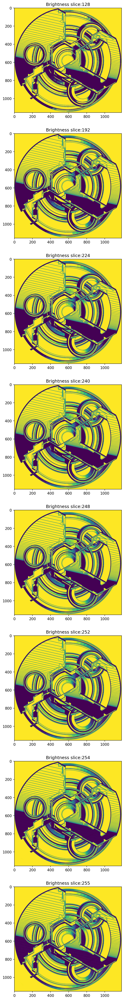

In [376]:
img = cv2.imread('steve.png', cv2.IMREAD_GRAYSCALE)[135:1290,130:1315]

fig = plt.figure(figsize=(14, 50), dpi=150)
plt.tight_layout()
counter=1
for i in [np.uint8(128),np.uint8(192),np.uint8(224),np.uint8(240),np.uint8(248),np.uint8(252),np.uint8(254),np.uint8(255),]:
    plt.subplot(8, 1, counter)
    plt.title(f'Brightness slice:{i}')
    plt.imshow(cv2.bitwise_and(img,np.zeros(img.shape, dtype="uint8")+i))
    counter=counter+1

plt.show()
cv2.bitwise_and(img,np.zeros(img.shape, dtype="uint8")+np.uint8(252))

In [372]:
np.uint8()

0

In [369]:
img.shape

(1155, 1185)

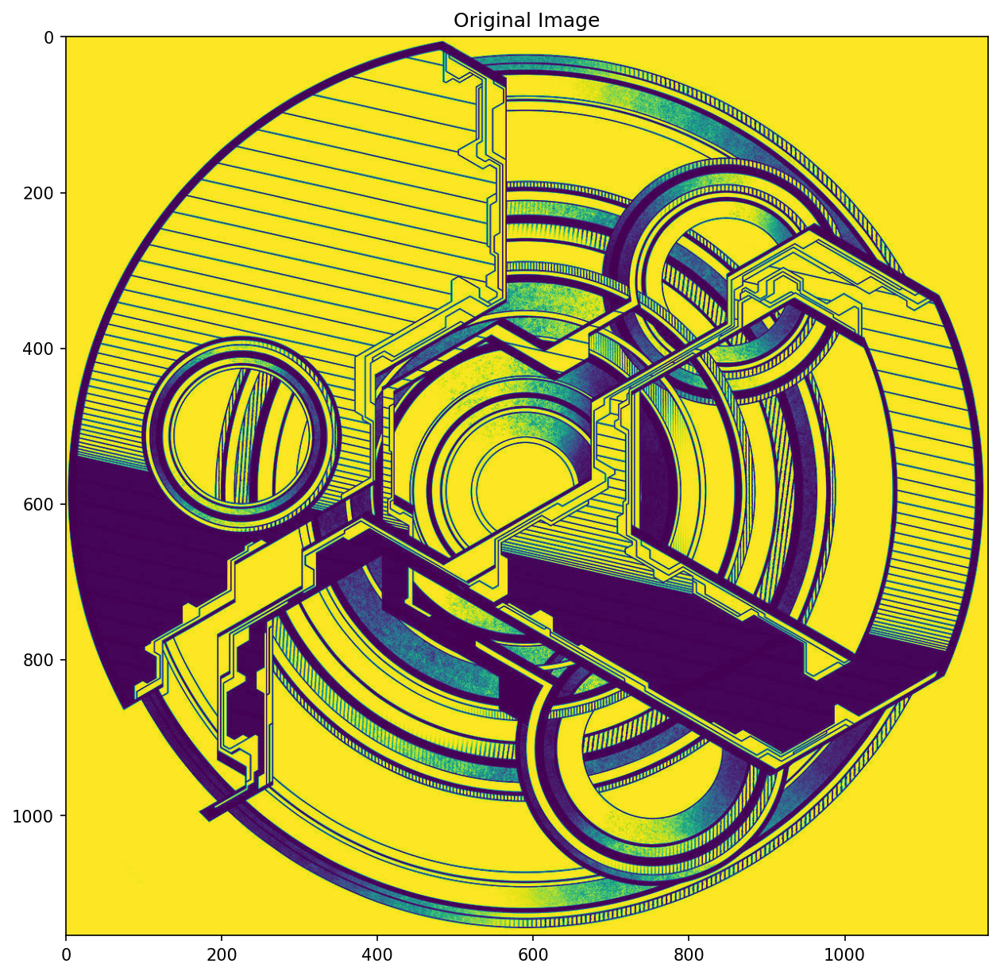

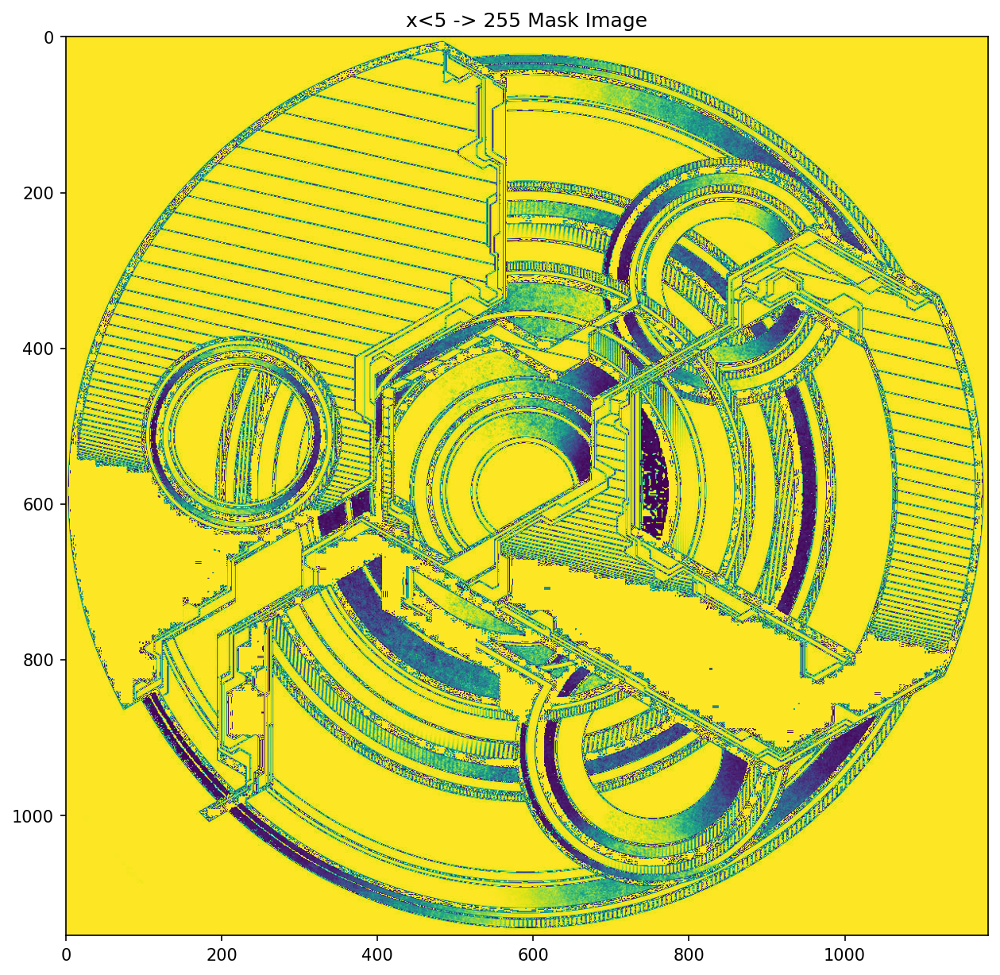

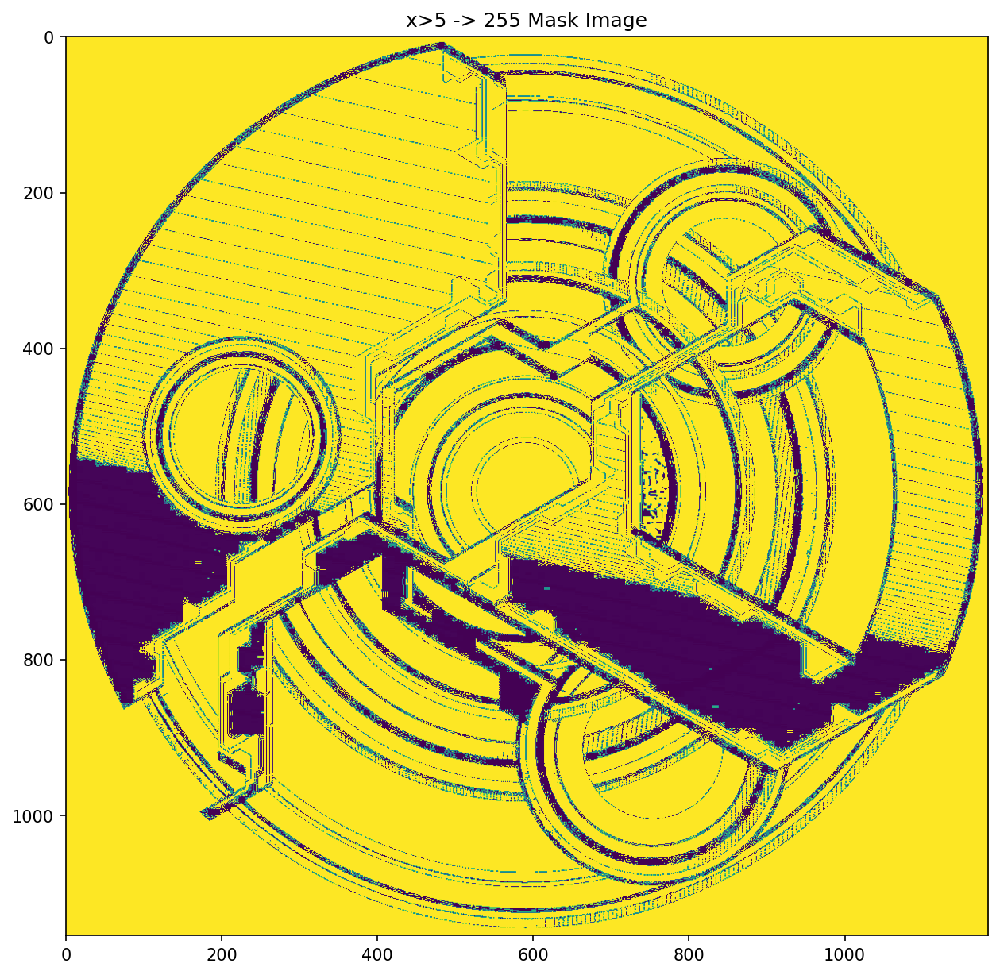

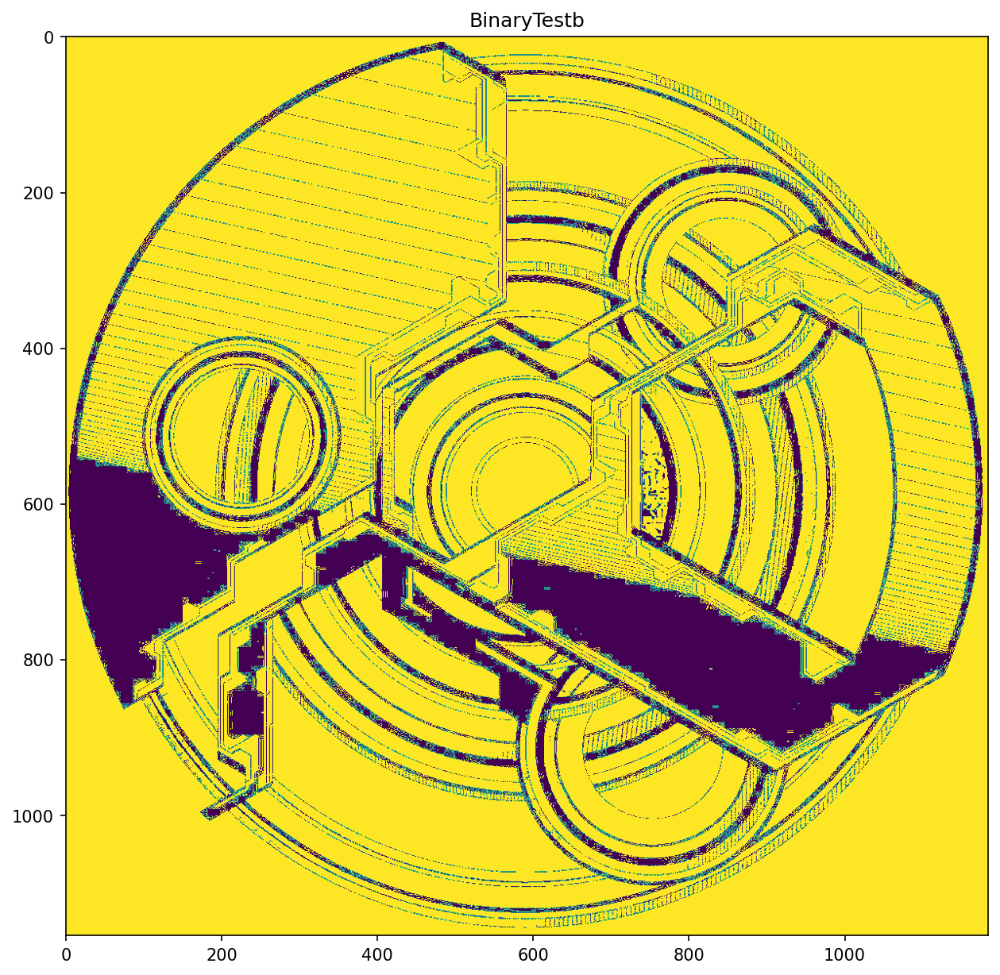

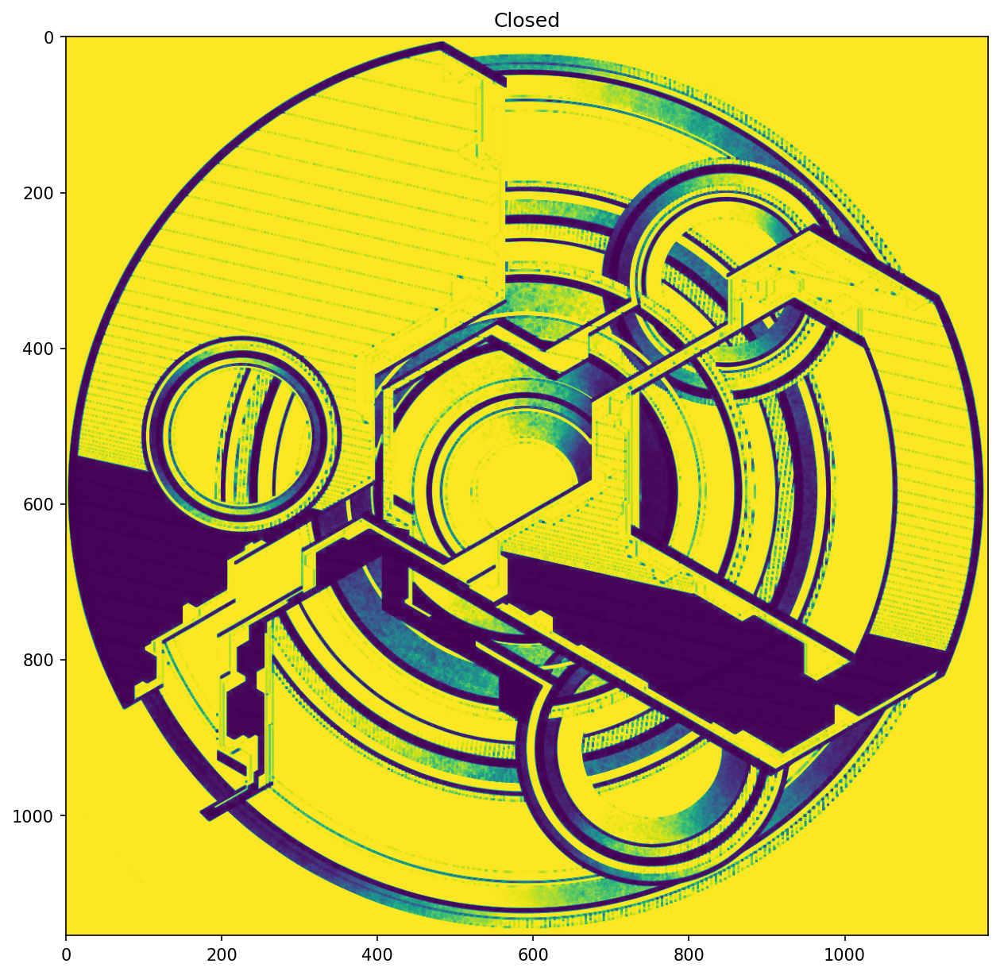

...

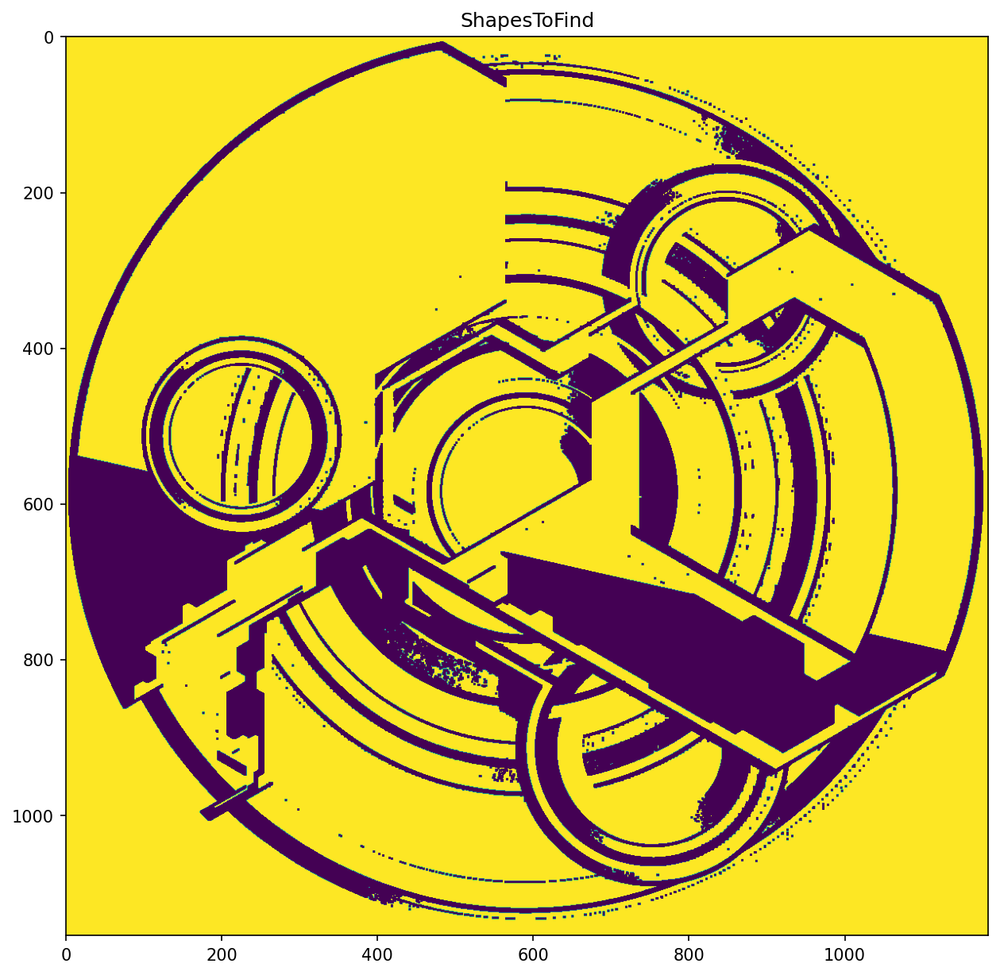

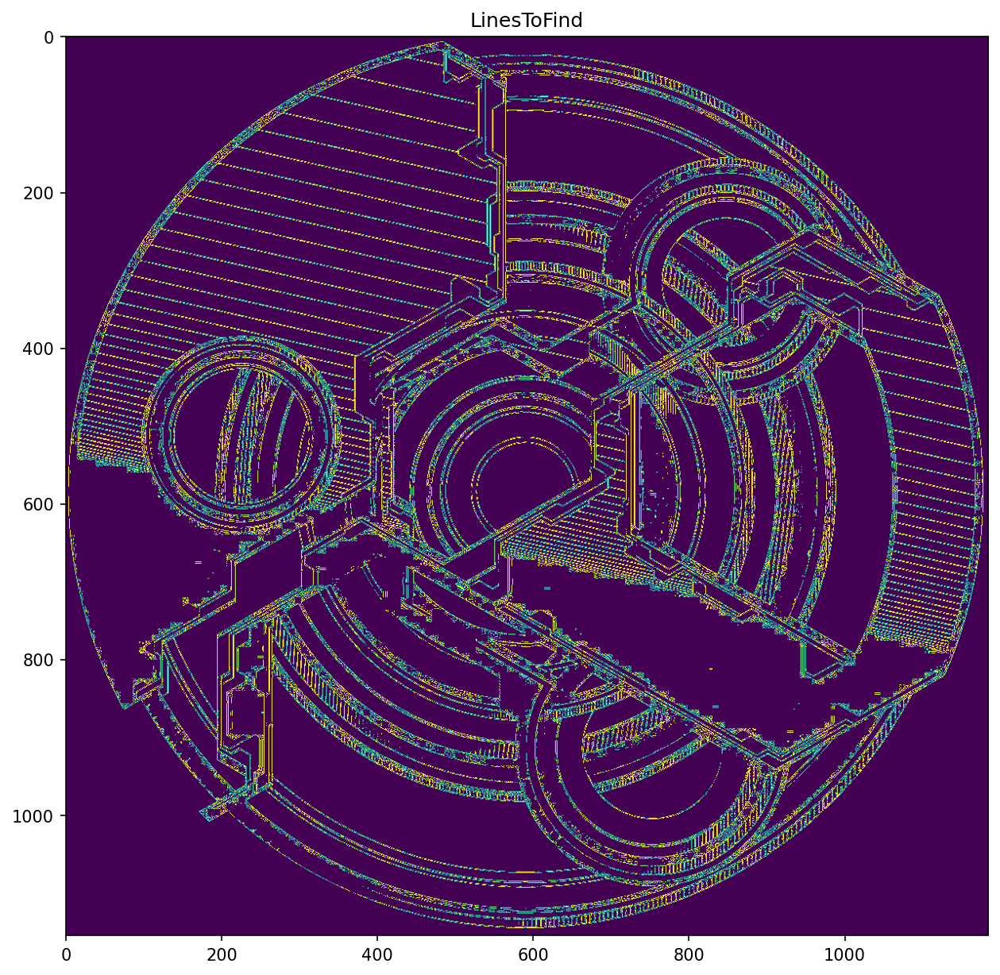

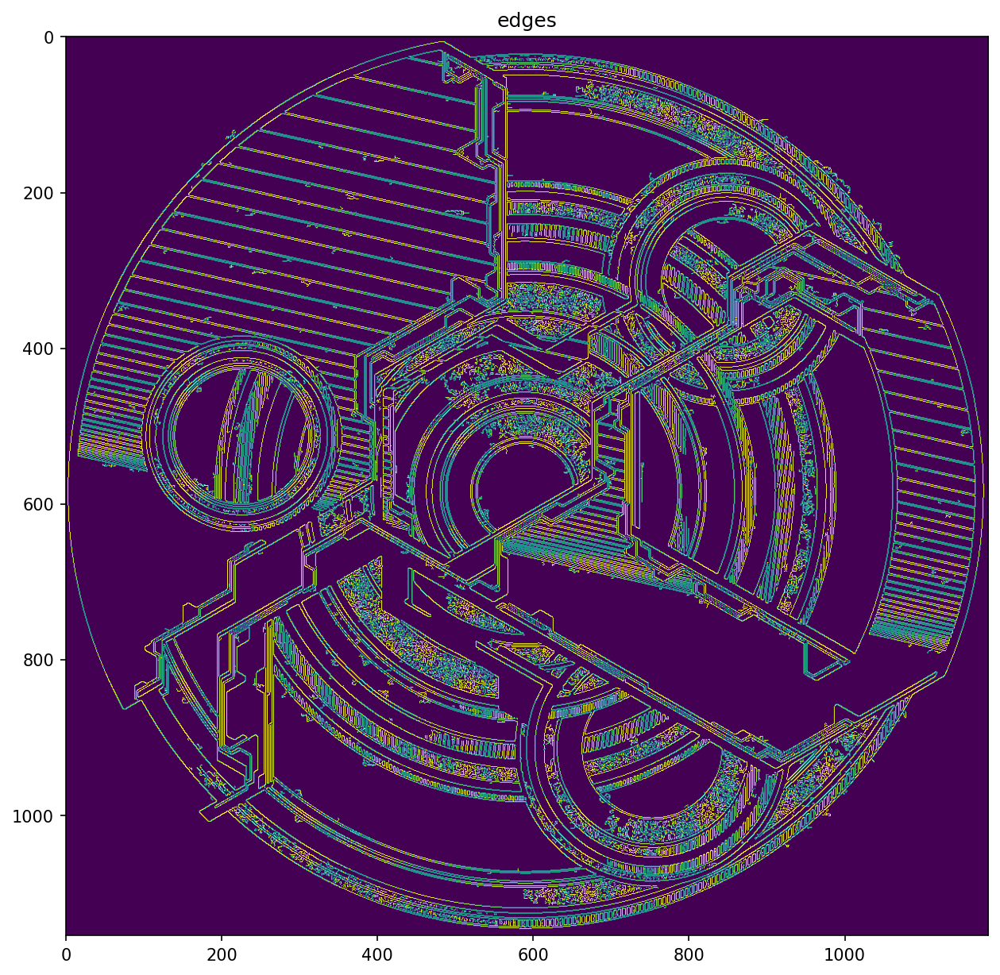

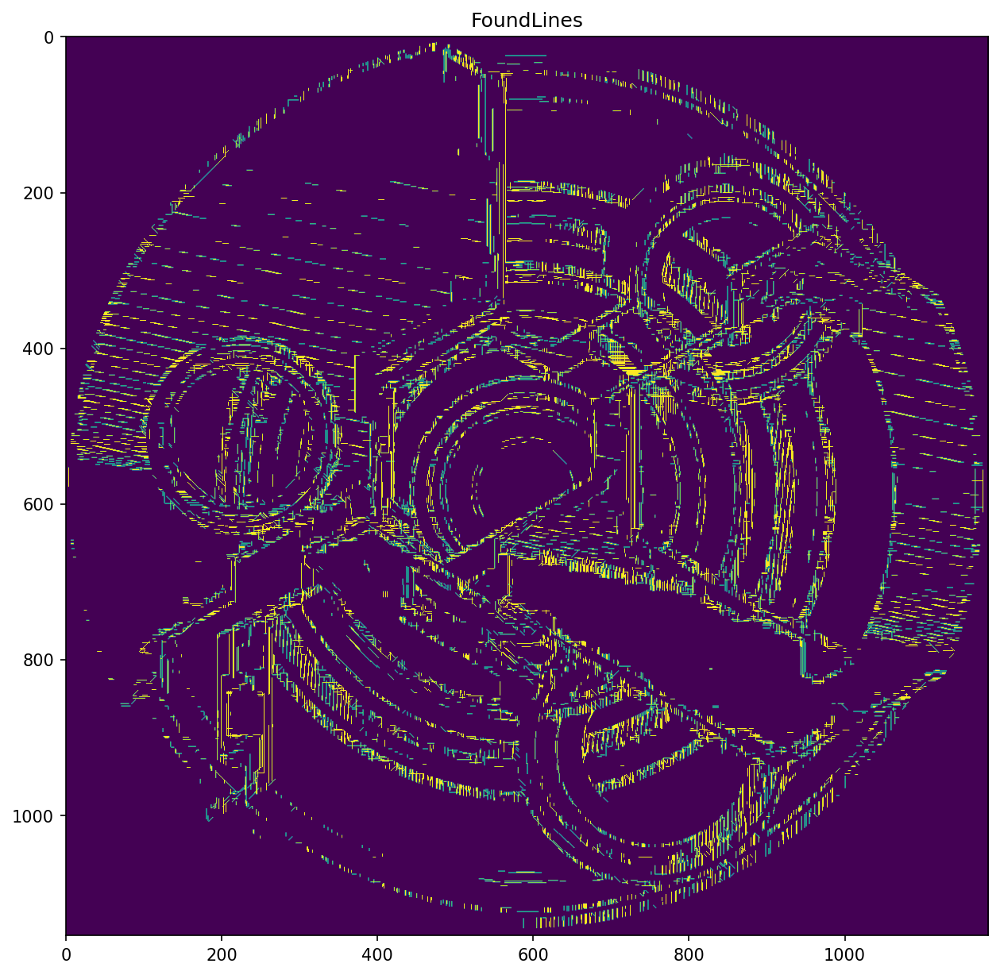

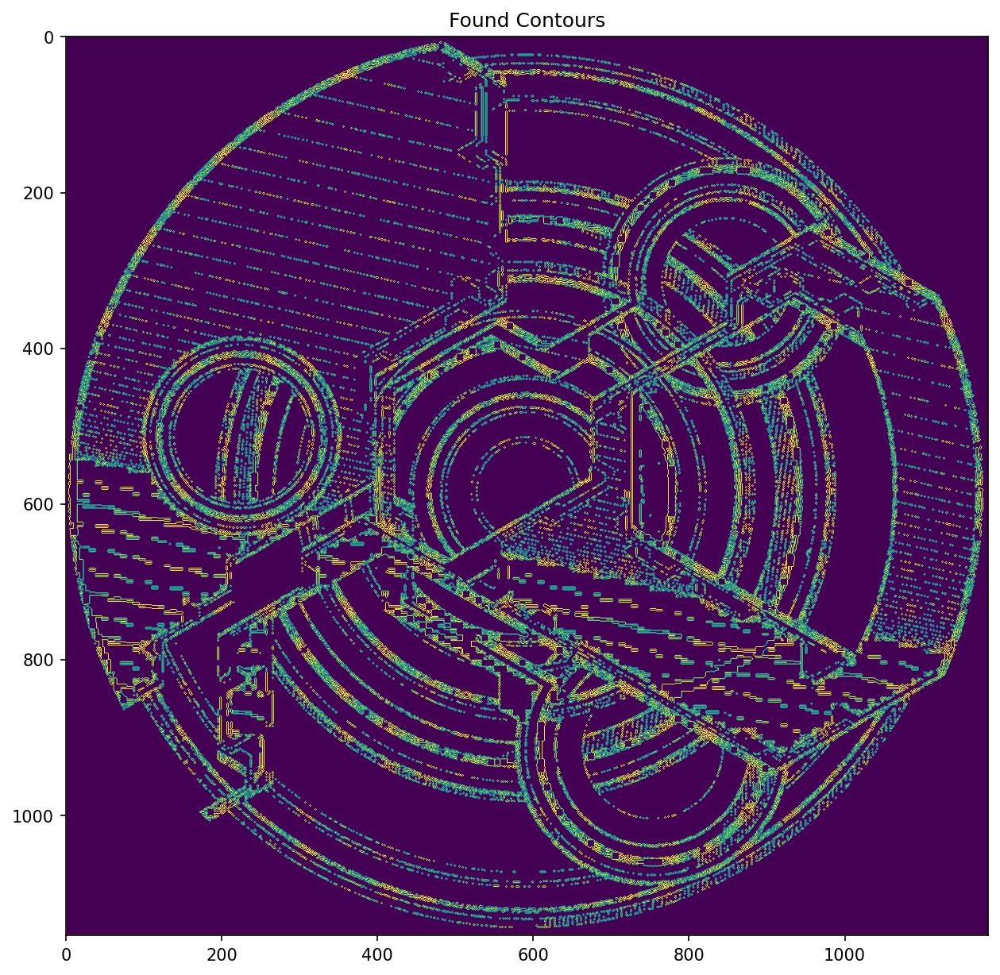

In [239]:
_,ShapesToFind = cv2.threshold(closing,150,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
plt.figure(figsize=(10, 10), dpi=150)
plt.title('ShapesToFind')
plt.imshow(ShapesToFind)

_,LinesToFind = cv2.threshold(BlackHat,150,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
plt.figure(figsize=(10, 10), dpi=150)
plt.title('LinesToFind')
plt.imshow(LinesToFind)

edges = cv2.Canny(img, 15, 100)
plt.figure(figsize=(10, 10), dpi=150)
plt.title('edges')
plt.imshow(edges)

empt = np.zeros(img.shape)

lines = cv2.HoughLinesP(LinesToFind, 0.1, np.pi/360, 50, minLineLength=3, maxLineGap=2)
if lines is not None:
    for line in lines:
        x1, y1, x2, y2 = line[0]
        cv2.line(empt, (x1, y1), (x2, y2), (200, 200, 200), 1) 
plt.figure(figsize=(10, 10), dpi=150)
plt.title('FoundLines')
plt.imshow(empt)           

contours, _ = cv2.findContours(img, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)

overlay = cv2.drawContours(image=np.zeros(img.shape), contours=contours, contourIdx=-1, color=(255, 255, 255), thickness=1, lineType=cv2.LINE_AA)
plt.figure(figsize=(10, 10), dpi=150)
plt.title('Found Contours')
plt.imshow(overlay)  

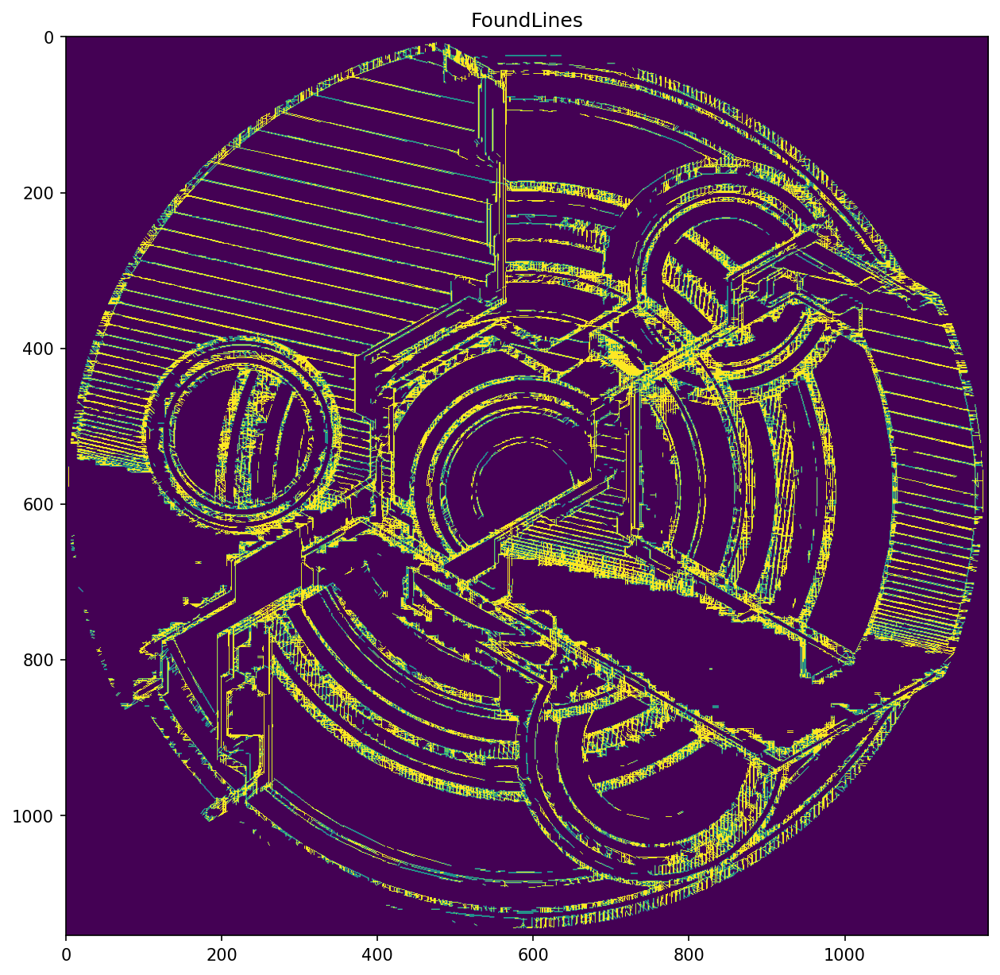

In [226]:
lines = cv2.HoughLinesP(LinesToFind, 1, np.pi/360, 50, minLineLength=3, maxLineGap=3)
if lines is not None:
    for line in lines:
        x1, y1, x2, y2 = line[0]
        cv2.line(empt, (x1, y1), (x2, y2), (200, 200, 200), 1) 
plt.figure(figsize=(10, 10), dpi=150)
plt.title('FoundLines')
plt.imshow(empt)